# Fantasy maps datasets and models

Log of attempts:

* **Try 1.** We used the top left-most cell for training the model. This resulted in predictions with a cluster of bounding boxes along the corners.
  + Dataset: `projects/147301782967/locations/us-central1/datasets/4591639722429775872`
  + Model: `projects/147301782967/locations/us-central1/models/6748089887754289152`
  + Endpoint: `projects/147301782967/locations/us-central1/endpoint/7556530001332404224`

* **Try 2.** We used the 1th cell (2nd from top, second from left) cell for training the model. This also resulted in predictions with a cluster of bounding boxes along the corners.
  + Dataset: `projects/147301782967/locations/us-central1/datasets/5740620577362673664`
  + Model: `projects/147301782967/locations/us-central1/models/8978216128232816640`
  + Endpoint: `projects/147301782967/locations/us-central1/endpoint/3245177783055286272`

* **Try 3.** _MVP_. We placed bounding boxes over ALL the cells in the training data.
  + Dataset: `projects/147301782967/locations/us-central1/datasets/6572379133542662144`
  + Model: `projects/147301782967/locations/us-central1/models/6227079705862864896`
  + Endpoint: `projects/147301782967/locations/us-central1/endpoint/6490584264529149952`

* **Try 4.** After creating an MVP online model, we tried to create an exportable, high-accuracy TF model. Unfortunately, our results, a seen in the model evaluations, were not very promising.
  + Dataset: Same as Try 3.
  + Model: `projects/147301782967/locations/us-central1/models/1526408012376309760`
  + Endpoint: `projects/147301782967/locations/us-central1/endpoint/1207721164135202816`

* **Try 5.** After the previous unsuccessful attempt to create an edge model (Try #4), we decided to try changing the training parameters a little bit: increasing the milli node hours to 100K; changing the test train split to 80/10/10 (was 70/20/10).
  + Dataset: Same as Try 3.
  + Failure. The model evaluations showed an average precision and recall of 0 (!). 

* **Try 6.** Created a pipeline that:
  + Trains two models, one online and the other Edge
  + Creates a new dataset based upon increased data
    - New dataset created by batch prediction using existing online model (MVP).
    - After batch prediction, the pipeline adds the new map & map coords data into the GCS bucket for the main pipeline flow.
  

Alternatives considered:

  + [Tensorflow image object detection](https://www.tensorflow.org/lite/examples/object_detection/overview)
  + [Hough transforms](https://towardsdatascience.com/lines-detection-with-hough-transform-84020b3b1549)
  + [Image convolutions](https://aishack.in/tutorials/image-convolution-examples/)

Process / work items:

  1. Get an exportable TF model.
  1. Generate C library (minimal) that calls into TF model
  1. Test C library with real files
  1. OSSPO process for library
  1. Release! 

# START HERE: Set up GCP environment

First we need to install all of our libraries--including the Vertex AI library--so that we can restart the kernel before doing anything else.

In [5]:
!pip install  --user jsonlines imgaug imageio pillow google-cloud-storage google-cloud-aiplatform==1.3.0 kfp google-cloud-pipeline-components

Verify your library settings and Python version (for troubleshooting purposes).

In [7]:
! pip show google-cloud-aiplatform
! python --version

Name: google-cloud-aiplatform
Version: 1.3.0
Summary: Cloud AI Platform API client library
Home-page: https://github.com/googleapis/python-aiplatform
Author: Google LLC
Author-email: googleapis-packages@google.com
License: Apache 2.0
Location: /home/jupyter/.local/lib/python3.7/site-packages
Requires: google-api-core, google-cloud-storage, google-cloud-bigquery, packaging, proto-plus
Required-by: google-cloud-pipeline-components, fantasy-maps
Python 3.7.10


In [2]:
#@markdown Store the resource names for this experiment

display_name = 'dnd-maps-pipeline'  #@param {type: "string"}
PROJECT_ID = 'video-erschmid' #@param {type: "string"}
LOCATION = 'us-central1' #@param {type: "string"}
GCS_TRAINING_SOURCE = 'gs://video-erschmid/DnD/map_training_data.jsonl'
dataset_id = '6572379133542662144' #@param {type: "string"}
model_id = '5982671465147793408' #@param {type: "string"}
endpoint_id = '835681613667893248' #@param {type: "string"}
gcs_bucket_name = 'video-erschmid' #@param {type: "string"}
batch_prediction_gcs_source = 'video-erschmid/DnD-batch-predict-input' #@param {type: "string"}


Authenticate the current logged in user. This allows you to use the Google Cloud Platform projects associated with your email address.

In [13]:
## COLAB ONLY! ##
from google.colab import auth
auth.authenticate_user()

ModuleNotFoundError: No module named 'google.colab'

Set your current Google Cloud Project project ID with the `gcloud` tool (Google Cloud SDK). This helps when moving files to and from Cloud Storage buckets.

In [14]:
!gcloud config get-value project
!gcloud config set project $PROJECT_ID
!gcloud config get-value project

video-erschmid
Updated property [core/project].
video-erschmid




Lastly, run the next cell in order to keep an image analyzer function in memory.



**_HACK_**: The following shows another way to use service accounts in Colab notebook. This code mounts a Drive folder and moves an existing service account credential file over.

You should not need this cell if you run `auth.authenticate_user()` method from a previous cell.

In [ ]:
import shutil
from datetime import datetime

now = datetime.now()
date_str = now.strftime("%Y_%m_%d_%H_%M_%S")

print(date_str)

DRIVE_PROJECT_FOLDER = 'drive/My Drive/Data/project_data'
SA_CREDENTIALS = f'{PROJECT_ID}.json'

# Progammatically mount drive (on runtime restart)
from google.colab import drive
drive.mount('/content/drive')


# Move credentials files from Drive to here
shutil.copy(f'{DRIVE_PROJECT_FOLDER}/{SA_CREDENTIALS}', '.')

2021_06_22_18_02_07
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


'./video-erschmid.json'

# Load dataset manifest file into memory

In order to create a dataset, we need to have all of our training data (images) in a Google Cloud Storage bucket.

Ideally we'd have an easy way to move Drive files to Storage ... but we don't. Humph. 

We'll start by opening up the index file from the maps folder.

In [147]:
!   pip install --upgrade google-api-python-client google-auth-httplib2 google-auth-oauthlib

     |████████████████████████████████| 7.4 MB 5.0 MB/s eta 0:00:01
  Attempting uninstall: google-auth-oauthlib
    Found existing installation: google-auth-oauthlib 0.4.5
    Uninstalling google-auth-oauthlib-0.4.5:
      Successfully uninstalled google-auth-oauthlib-0.4.5
  Attempting uninstall: google-api-python-client
    Found existing installation: google-api-python-client 1.12.8
    Uninstalling google-api-python-client-1.12.8:
      Successfully uninstalled google-api-python-client-1.12.8
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
kfp 1.7.2 requires google-api-python-client<2,>=1.7.8, but you have google-api-python-client 2.20.0 which is incompatible.


In [ ]:
import os
import shutil

gcs_bucket = 'video-erschmid'
gcs_prefix = 'DnD'
drive_base_path = 'drive/MyDrive/dnd-maps'
gridded = 'Gridded'
index = 'index.json'

# Create the maps directory
#os.mkdir('sample_data/maps')

shutil.copy(f'{drive_base_path}/{index}', './sample_data/maps/')

'./sample_data/maps/index.json'

Massage existing data into a JSONL format

In [ ]:
with open('./sample_data/maps/index.json', 'r') as file:
  f_str = file.read()

f_str = f_str.replace('[\n', '')
f_str = f_str.replace('\n]', '')
f_str = f_str.replace('\n', '')
f_str = f_str.replace('},', '}\n')

with open('./sample_data/maps/index_tmp.json', 'w+') as file:
  file.write(f_str)


Read in the JSONL file. 

[JSONL library](https://jsonlines.readthedocs.io/en/latest/)

In [ ]:
import jsonlines

jsonl = []

with jsonlines.open('./sample_data/maps/index_tmp.json') as reader:
  for item in reader:
    jsonl.append(item)

# Move files over to Storage (one-time only)

Move a copy of each file over to Storage from Google Drive. This requires mounting Google Drive to the notebook and then moving each file over.

In [ ]:
# Make a copy of each file locally

for map_ in jsonl:
  try:
    path = map_['path']
    shutil.copy(f'{drive_base_path}/{path}', './sample_data/maps/')
  
  except:
    print("Unexpected error:", sys.exc_info()[0])
    pass


NameError: ignored

In [ ]:
!pip install google-cloud-storage

In [ ]:
from google.cloud import storage

storage_client = storage.Client()
bucket = storage_client.bucket(gcs_bucket)

"""
first_item = jsonl[0]['path']
file_name = first_item.split('/')[2]
print(gcs_bucket)
print(file_name)
blob = bucket.blob(f'DnD/{file_name}')
with open(f'sample_data/maps/{file_name}', 'rb') as file:
  blob.upload_from_file(file)
"""

for item in jsonl:
  path = item['path']
  file_path = f'{drive_base_path}/{path}'
  
  file_name = path.split('/')[2]
  print(f'Processing: {file_name} ...')
  print(file_path)

  blob = bucket.blob(f'DnD/{file_name}')
  blob.upload_from_filename(file_path)


NameError: ignored

# Create data label annotations

[uCAIP IOD documentation about data prep](https://cloud.google.com/ai-platform-unified/docs/datasets/prepare-image#object-detection)

First step: we need to switch our training data into the format used by uCAIP:

```
{
  "imageGcsUri": "gs://bucket/filename.ext",
  "boundingBoxAnnotations": [
    {
      "displayName": "OBJECT1_LABEL",
      "xMin": "X_MIN",
      "yMin": "Y_MIN",
      "xMax": "X_MAX",
      "yMax": "Y_MAX",
      "annotationResourceLabels": {
        "aiplatform.googleapis.com/annotation_set_name": "displayName",
        "env": "prod"
      }
    },
    {
      "displayName": "OBJECT2_LABEL",
      "xMin": "X_MIN",
      "yMin": "Y_MIN",
      "xMax": "X_MAX",
      "yMax": "Y_MAX"
    }
  ],
  "dataItemResourceLabels": {
    "aiplatform.googleapis.com/ml_use": "test/train/validation"
  }
}
```

As part of this process, we need to identify the first top left cell where two gridlines meet. The first step is to compose a JSONL document with the GCS URIs. We can compose this document by iterating over the items in our GCS bucket.

**Note**: Another option is to simply upload the images into Vertex AI and then label the images there. This might be the best option given this dataset.


Once we have a reference to the blobs in the GCS bucket, we can iterate over the blobs and create our new JSONL document.

The format:

```
{ "imageGcsUri": "gs://video-erschmid/DnD/Some_Map.jpg",    
  "boundingBoxAnnotations": [
    {
      "displayName": "top_left_cell",
      "xMin": "0",
      "yMin": "0",
      "xMax": "X_MAX",
      "yMax": "Y_MAX"
    }
  ]
}
```

In [ ]:
# Need to verify that JSON input file was processed correctly
print(jsonl[0])
TEST_ANNOTATE_FILE = "/content/sample_data/maps/G_AbandonedMineEntrance_Crystal.jpg"

{'imageWidth': 4900, 'imageHeight': 7000, 'cellOffsetX': 0, 'cellOffsetY': 0, 'cellWidth': 140, 'cellHeight': 140, 'path': 'Cavern of the Venom Queen [35x50]/Gridded/G_CavernOfTheVenomQueen_BloodyCave.jpg'}


## Create the image annotations

Once we have loaded the original input file, we can massage the coordinates as needed into values that we need.

In [ ]:
import math

map_manifest = []

actual_map_coords = None

for m in jsonl:

  height = m['imageHeight']
  width = m['imageWidth']
  cell_width = m['cellWidth']
  cell_height = m['cellHeight']

  num_columns = math.floor(width / cell_width) - 1
  num_rows = math.floor(height / cell_height) - 1


  bboxes = []

  for x in range(1, num_columns):
    for y in range(1, num_rows):
      x_min_tmp = m['cellOffsetX'] + (cell_width * x) - 2
      x_max_tmp = x_min_tmp + cell_width + 4
      y_min_tmp = m['cellOffsetY'] + (cell_height * y) - 2
      y_max_tmp = y_min_tmp + cell_height + 4

      #print(f'{x_min_tmp},{x_max_tmp}: {y_min_tmp},{y_max_tmp}')

      x_min_train = x_min_tmp / width
      x_max_train = x_max_tmp / width
      y_min_train = y_min_tmp / height
      y_max_train = y_max_tmp / height

      bboxes.append({
        "xMin": x_min_train, 
        "yMin": y_min_train, 
        "yMax": y_max_train,
        "xMax": x_max_train
      })


  #print(f'{x_min_train},{x_max_train}: {y_min_train},{y_max_train}')

  path = m['path'].split('/')[-1]

  if cell_width is not 140:
    print(f'Wonky map: {path}')

  coords = {
      "path": path,
      "bboxes": bboxes,
      "width": width,
      "height": height
  }

  if TEST_ANNOTATE_FILE.find(path) is not -1:
    print(m)
    print(coords)
    actual_map_coords = coords
    print(f'width: {width}\nheight: {height}')
    print(f'columns: {num_columns}\nrows: {num_rows}')
    print(f'bboxes 1: {bboxes[0]}')
    print(f'bboxes 2: {bboxes[1]}')

  map_manifest.append(coords)

Wonky map: G_RealmOfDreams_FullMap_Day.jpg
Wonky map: G_RealmOfDreams_FullMap_Night.jpg
{'imageWidth': 4620, 'imageHeight': 2940, 'cellOffsetX': 0, 'cellOffsetY': 0, 'cellWidth': 140, 'cellHeight': 140, 'path': 'Abandoned Mine Entrance [33x21] - $5 Rewards/Gridded/G_AbandonedMineEntrance_Crystal.jpg'}
{'path': 'G_AbandonedMineEntrance_Crystal.jpg', 'bboxes': [{'xMin': 0.02987012987012987, 'yMin': 0.04693877551020408, 'yMax': 0.09591836734693877, 'xMax': 0.06103896103896104}, {'xMin': 0.02987012987012987, 'yMin': 0.0945578231292517, 'yMax': 0.1435374149659864, 'xMax': 0.06103896103896104}, {'xMin': 0.02987012987012987, 'yMin': 0.14217687074829932, 'yMax': 0.19115646258503402, 'xMax': 0.06103896103896104}, {'xMin': 0.02987012987012987, 'yMin': 0.18979591836734694, 'yMax': 0.23877551020408164, 'xMax': 0.06103896103896104}, {'xMin': 0.02987012987012987, 'yMin': 0.23741496598639455, 'yMax': 0.2863945578231292, 'xMax': 0.06103896103896104}, {'xMin': 0.02987012987012987, 'yMin': 0.28503401360

## Check the image annotations bounding boxes

The second try training ended up with some weird looking annotations. We need to identify how to find the correct locations of the annotations. To do this, we'll use the `imgaug` library to help us. 



**Try 1**. We attempted to identify the very first, top-left rectangle as the labeled object in the training data.

However, this resulted in a model that was identifying not-quite the first cell on the map. I suspect that it is related to: a) there isn't a full box for the model to identify; and b) the bounding boxes in the annotations were placed right on top of the grid lines.

**Try 2.** For the second attempt, we're going to place the bounding boxes on a 2px offset around the top-left *full* cell on the grid.

Thus, a grid with these values:

```
cellOffsetX = 0
cellOffsetY = 0
cellHeight = 140
cellWidth = 140
```

... will have a bounding box with these values:

```
xMin = cellOffsetX + cellWidth - 2
xMax = cellOffsetX + 2 * cellWidth + 2
yMin = cellOffsetY + cellHeight - 2
yMax = cellOffsetY + 2 * cellHeight + 2

```

In [ ]:
from google.colab import auth
auth.authenticate_user()

! mkdir sample_data/maps
! gsutil cp gs://video-erschmid/DnD/annotation_practice/G_AbandonedMineEntrance_Crystal.jpg sample_data/maps/

mkdir: cannot create directory ‘sample_data/maps’: File exists
Copying gs://video-erschmid/DnD/annotation_practice/G_AbandonedMineEntrance_Crystal.jpg...
/ [1 files][  2.5 MiB/  2.5 MiB]                                                
Operation completed over 1 objects/2.5 MiB.                                      


Now we need to load the test image into the notebook using `imgaug`.

In [ ]:
import imageio
import imgaug as ia
import imgaug.augmenters as iaa
from imgaug.augmentables.bbs import BoundingBox, BoundingBoxesOnImage

ia.seed(1)

%matplotlib inline

image = imageio.imread(TEST_ANNOTATE_FILE)


Now we need to get the coordinate data that corresponds to this image.

In [ ]:
# This gets the actual output
! gsutil cp gs://video-erschmid/DnD/map_training_data.jsonl content/sample_data/maps/

test_file_coords = None

for map_coords in jsonl:
  path = map_coords['path'].split('/')[-1]
  if TEST_ANNOTATE_FILE.find(path) is not -1:
    print(map_coords)
    test_file_coords = map_coords

Copying gs://video-erschmid/DnD/map_training_data.jsonl...
Skipping attempt to download to filename ending with slash                      
(content/sample_data/maps/). This typically happens when using gsutil
to download from a subdirectory created by the Cloud Console
(https://cloud.google.com/console)

Operation completed over 1 objects/116.2 KiB.                                    
{'imageWidth': 4620, 'imageHeight': 2940, 'cellOffsetX': 0, 'cellOffsetY': 0, 'cellWidth': 140, 'cellHeight': 140, 'path': 'Abandoned Mine Entrance [33x21] - $5 Rewards/Gridded/G_AbandonedMineEntrance_Crystal.jpg'}


Once we have the correct coordinates, we need to check whether the bounding boxes from our input values are placed correctly.

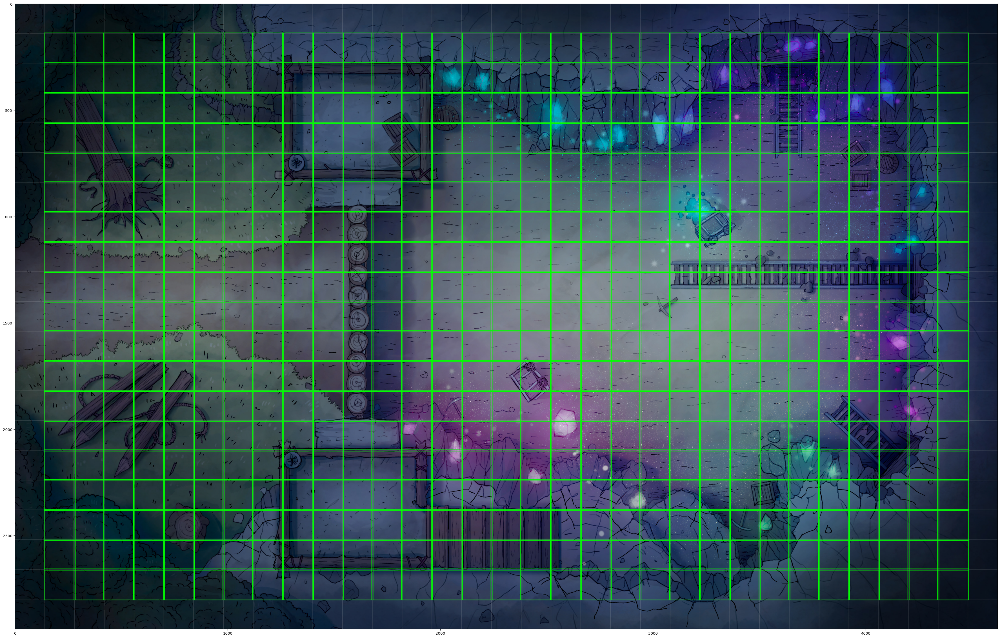

In [ ]:
bboxes_on_image = []

for x in range(31):
  for y in range(19):

    bboxes_on_image.append(BoundingBox(x1=138 + (140 * x),
                                      x2=282 + (140 * x),
                                      y1=138 + (140 * y), 
                                      y2=282 + (140 * y))
    )


bbs = BoundingBoxesOnImage(bboxes_on_image, shape=image.shape)

ia.imshow(bbs.draw_on_image(image, size=3))

Next we need to verify that the annotation values that we're sending to the service are correct. 

Check that the coordinates stored in the file are accurate.

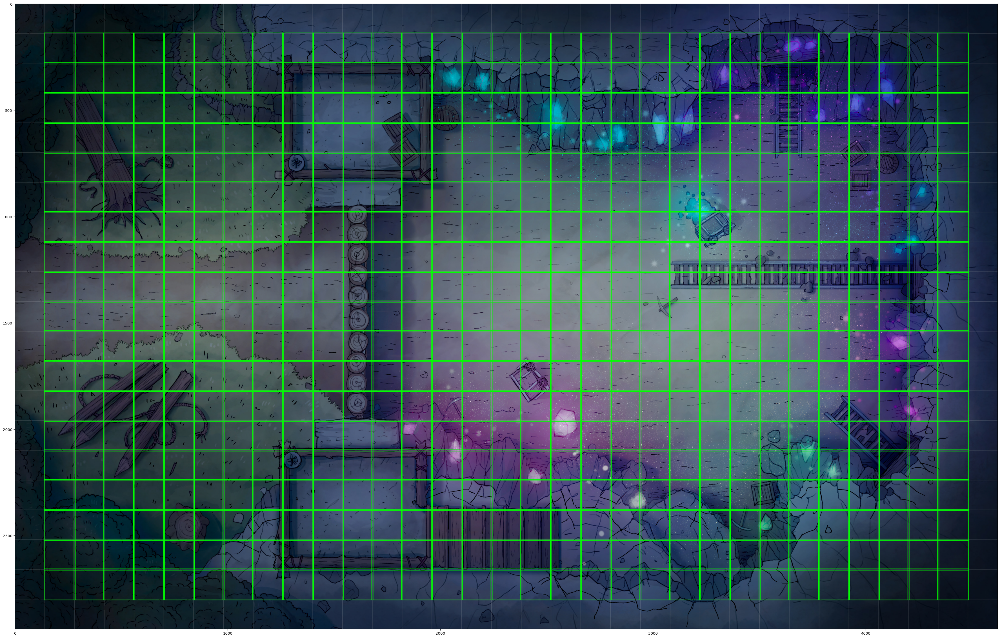

In [ ]:
bboxes_on_image = []

for bbox in actual_map_coords['bboxes']:
  x_min_actual = bbox['xMin'] * actual_map_coords['width']
  x_max_actual = bbox['xMax'] * actual_map_coords['width']
  y_min_actual = bbox['yMin'] * actual_map_coords['height']
  y_max_actual = bbox['yMax'] * actual_map_coords['height']

  bboxes_on_image.append(BoundingBox(x1=x_min_actual,
                                   x2=x_max_actual,
                                   y1=y_min_actual, 
                                   y2=y_max_actual))

"""
print(f'width: {actual_map_coords["width"]}, height: {actual_map_coords["height"]}')
print(f'{x_min_actual},{y_min_actual} : {x_max_actual},{y_max_actual}')
"""


bbs = BoundingBoxesOnImage(bboxes_on_image, shape=image.shape)

ia.imshow(bbs.draw_on_image(image, size=3))


## Build the annotation file for the dataset

After the JSON input file has been processed, we need to convert the input data into the format that the AutoML image object detection model can understand.



In [ ]:
from google.cloud import storage

In [ ]:
def get_image_bounding_box(name):
  for map_info in map_manifest:
    if name.find(map_info['path']) > -1:
      return map_info
  
  print(name)

In [ ]:
storage_client = storage.Client(project="video-erschmid")
bucket = storage_client.bucket(gcs_bucket)
blob_names = bucket.list_blobs()

with jsonlines.open('./sample_data/maps/map_training_data.jsonl', mode='w') as writer:
  for blob_name in blob_names:
    if blob_name.name.find('jpg') > -1:
      map_info = get_image_bounding_box(blob_name.name)

      if map_info == None:
        continue

      bboxes = map_info["bboxes"]

      for bbox in bboxes:
        bbox["displayName"] = "cell"

      writer.write({
          "imageGcsUri": f"gs://{gcs_bucket}/{blob_name.name}",
          "boundingBoxAnnotations": bboxes
      })

DnD/prediction-inputs/gridded-desert-ground.jpg
DnD/prediction-inputs/gridded-ruined-keep.jpg
DnD/prediction-inputs/gridded-small-keep.jpg


Finally, we can write the training data file back to GCS.

In [ ]:
blob = bucket.blob(f'DnD/map_training_data.jsonl')
blob.upload_from_filename('./sample_data/maps/map_training_data.jsonl')

# Create the image object detection dataset

For this next step, we are going to create the image object detection dataset programmatically (but will annotate the images using the UI).

In [ ]:
! pip show google-cloud-aiplatform

Name: google-cloud-aiplatform
Version: 1.0.0
Summary: Cloud AI Platform API client library
Home-page: https://github.com/googleapis/python-aiplatform
Author: Google LLC
Author-email: googleapis-packages@google.com
License: Apache 2.0
Location: /root/.local/lib/python3.7/site-packages
Requires: google-cloud-bigquery, google-api-core, proto-plus, packaging, google-cloud-storage
Required-by: 


In [ ]:
from google.cloud import aiplatform

try:
  print(f"Project is: {PROJECT_ID}")
except NameError:
  PROJECT_ID = 'video-erschmid'

  
location='us-central1'

aiplatform.init(project=PROJECT_ID, location=location)

Project is: video-erschmid


Inspect the manifest file to make sure that the x & y values are correct.

In [ ]:
! gsutil cp gs://video-erschmid/DnD/map_training_data.jsonl .

Copying gs://video-erschmid/DnD/map_training_data.jsonl...
- [1 files][ 76.6 MiB/ 76.6 MiB]                                                
Operation completed over 1 objects/76.6 MiB.                                     


In [ ]:
from datetime import datetime

timestamp = datetime.timestamp(datetime.now())
image_od_dataset = aiplatform.ImageDataset.create(
    display_name=f'{display_name}-{timestamp}',
    gcs_source='gs://video-erschmid/DnD/map_training_data.jsonl',
    import_schema_uri=aiplatform.schema.dataset.ioformat.image.bounding_box,
    sync=False
)

# Train the model (online predictions)

This step can be taken in the console or programmatically. 

As always, we need to start by importing and initializing the library.

In [ ]:
from google.cloud import aiplatform

aiplatform.init(project=PROJECT_ID, location="us-central1")

Next we need to make sure we have a reference to our image dataset.

In [ ]:
try:
  image_od_dataset is not None
except:
  image_od_dataset = aiplatform.ImageDataset(dataset_id)


Finally we create the request that creates a model. This model is optimized for online prediction (`model_type="CLOUD_HIGH_ACCURACY_1"`).

This next step can take a while to complete. The training job continues to run even if you close this notebook.

In [ ]:
training_job = aiplatform.AutoMLImageTrainingJob(display_name=display_name,
                                                 prediction_type="object_detection",
                                                 model_type="CLOUD_HIGH_ACCURACY_1")
model = training_job.run(
        dataset=image_od_dataset,
        model_display_name=display_name,
        training_fraction_split=0.7,
        validation_fraction_split=0.2,
        test_fraction_split=0.1,
        sync=False,
    )

# Train the model (export to Tensorflow)

This step can be taken in the console or programmatically. 

As always, we need to start by importing and initializing the library.

In [ ]:
from google.cloud import aiplatform

try:
  print(f"Project is: {PROJECT_ID}")
except NameError:
  print("PROJECT_ID isn't set. Go back to 'START HERE'")

try:
  print(f"Location is: {LOCATION}")
except NameError:
  print("LOCATION isn't set. Go back to 'START HERE'")

aiplatform.init(project=PROJECT_ID, location=LOCATION)

Project is: video-erschmid
Location is: us-central1


Next, make sure that we have a reference to our dataset.

In [ ]:
try:
  image_od_dataset is not None
except:
  image_od_dataset = aiplatform.ImageDataset(dataset_id)


Finally, we define the training job for the model. In this case, we want to specify `model_type="MOBILE_TF_HIGH_ACCURACY_1"` in our training job for a model that can be exported.

In [ ]:
training_job_exportable = aiplatform.AutoMLImageTrainingJob(display_name=display_name,
                                                 prediction_type="object_detection",
                                                 model_type="MOBILE_TF_HIGH_ACCURACY_1")
exportable_model = training_job_exportable.run(
        dataset=image_od_dataset,
        model_display_name=display_name,
        training_fraction_split=0.8,
        validation_fraction_split=0.1,
        test_fraction_split=0.1,
        budget_milli_node_hours=100000, # This is the maximum for an exportable TF model
        sync=False,
    )

# Deploy the model

After the model has completed training, it needs to be deployed to an endpoint for online prediction.

In [ ]:
from google.cloud import aiplatform

models = aiplatform.Model.list()
print(models)

resource name: projects/147301782967/locations/us-central1/models/6227079705862864896, <google.cloud.aiplatform.models.Model object at 0x7f7695050750> 
resource name: projects/147301782967/locations/us-central1/models/8978216128232816640, <google.cloud.aiplatform.models.Model object at 0x7f768ff60f50> 
resource name: projects/147301782967/locations/us-central1/models/6748089887754289152]


In [ ]:
model = aiplatform.Model('projects/147301782967/locations/us-central1/models/6227079705862864896')

deployed_model_display_name="dnd-maps-model-all-cells-left-bias"

model.deploy(
    deployed_model_display_name=deployed_model_display_name,
    sync=True
)

model.wait()

INFO:google.cloud.aiplatform.models:Creating Endpoint
INFO:google.cloud.aiplatform.models:Create Endpoint backing LRO: projects/147301782967/locations/us-central1/endpoints/6490584264529149952/operations/8975986593529593856
INFO:google.cloud.aiplatform.models:Endpoint created. Resource name: projects/147301782967/locations/us-central1/endpoints/6490584264529149952
INFO:google.cloud.aiplatform.models:To use this Endpoint in another session:
INFO:google.cloud.aiplatform.models:endpoint = aiplatform.Endpoint('projects/147301782967/locations/us-central1/endpoints/6490584264529149952')
INFO:google.cloud.aiplatform.models:Deploying model to Endpoint : projects/147301782967/locations/us-central1/endpoints/6490584264529149952
INFO:google.cloud.aiplatform.models:Deploy Endpoint model backing LRO: projects/147301782967/locations/us-central1/endpoints/6490584264529149952/operations/4616502154234953728
INFO:google.cloud.aiplatform.models:Endpoint model deployed. Resource name: projects/14730178296

# Create a bootstrapping pipeline

In this step, we will create a training pipeline that will result in gradually improved models over successive runs.

1. Run batch prediction with the LKG / MVP of the online model. Batch prediction will identify cells in maps contained withinan "input" a GCS bucket

  + Results are processed--cell coordinates are determined both in DnD format and in image training format.
  + Maps from input are moved into a dataset GCS bucket.
  + Contents of input maps bucket are deleted.

2. Create a new dataset from the old + new (from batch predict) data.

3. Train two new models: an online `CLOUD` model and a high-accuracy Edge model

4. Display metrics about each model.

In [9]:
import kfp
from google.cloud import storage
from google.cloud import aiplatform
from google_cloud_pipeline_components import aiplatform as gcc_aip
from kfp.v2 import compiler
from kfp.v2.google.client import AIPlatformClient

## Create the simple image object detection pipeline

This code based upon the notebook [here](https://github.com/GoogleCloudPlatform/ai-platform-samples/blob/master/ai-platform-unified/notebooks/official/pipelines/google-cloud-pipeline-components_automl_images.ipynb).

In [3]:
from datetime import datetime

TIMESTAMP = datetime.now().strftime("%Y%m%d%H%M%S")
PIPELINE_ROOT = f"gs://{gcs_bucket_name}/pipeline_root"

## Define the pipeline

In [10]:
@kfp.dsl.pipeline(name=f"dnd-maps-training-and-deployment")
def pipeline(project: str = PROJECT_ID):
    dataset_op = gcc_aip.ImageDatasetCreateOp(
        project=project,
        display_name=f"dnd-maps-max-grid-{TIMESTAMP}",
        gcs_source=GCS_TRAINING_SOURCE,
        import_schema_uri=aiplatform.schema.dataset.ioformat.image.bounding_box,
    )

    training_job_online_run_op = gcc_aip.AutoMLImageTrainingJobRunOp(
        project=project,
        display_name=f"train-dnd-maps-full-grid-model-online-{TIMESTAMP}",
        prediction_type="object_detection",
        model_type="CLOUD_HIGH_ACCURACY_1",
        base_model=None,
        dataset=dataset_op.outputs["dataset"],
        model_display_name=f"dnd-maps-full-grid-model-online-{TIMESTAMP}",
        training_fraction_split=0.7,
        validation_fraction_split=0.2,
        test_fraction_split=0.1,
        budget_milli_node_hours=40000,
    )
    
    training_job_run_op = gcc_aip.AutoMLImageTrainingJobRunOp(
        project=project,
        display_name=f"train-dnd-maps-full-grid-model-exportable-{TIMESTAMP}",
        prediction_type="object_detection",
        model_type="MOBILE_TF_HIGH_ACCURACY_1",
        base_model=None,
        dataset=dataset_op.outputs["dataset"],
        model_display_name=f"dnd-maps-full-grid-model-exportable-{TIMESTAMP}",
        training_fraction_split=0.7,
        validation_fraction_split=0.2,
        test_fraction_split=0.1,
        budget_milli_node_hours=90000, # 100000 is the maximum for an exportable TF model
    )
    
    endpoint_op = gcc_aip.ModelDeployOp(
        project=project, model=training_job_online_run_op.outputs["model"]
    )

## Compile the pipeline and run it

In [11]:
from kfp.v2 import compiler  # noqa: F811

compiler.Compiler().compile(
    pipeline_func=pipeline, package_path="dnd_maps_pipeline.json"
)

In [12]:
from kfp.v2.google.client import AIPlatformClient  # noqa: F811

api_client = AIPlatformClient(project_id=PROJECT_ID, region=LOCATION)

/home/jupyter/.local/lib/python3.7/site-packages/kfp/v2/google/client/client.py:173: FutureWarning: AIPlatformClient will be deprecated in v1.9. Please use PipelineJob https://googleapis.dev/python/aiplatform/latest/_modules/google/cloud/aiplatform/pipeline_jobs.html in Vertex SDK. Install the SDK using "pip install google-cloud-aiplatform"
  category=FutureWarning,


In [13]:
response = api_client.create_run_from_job_spec(
    "dnd_maps_pipeline.json",
    pipeline_root=PIPELINE_ROOT,
    parameter_values={"project": PROJECT_ID},
)

## Create the simple batch prediction component

Start with a simple, one-component batch prediction pipeline. First we need to create a batch prediction input file.

In [146]:
from google.cloud import storage

storage_client = storage.Client(project=PROJECT_ID)

bp_bucket_name, bp_prefix_name = batch_prediction_gcs_source.split("/")[0:2]

print(bp_bucket_name)
print(bp_prefix_name)

# List all of the maps in the batch prediction bucket
maps_bucket = storage_client.bucket(bp_bucket_name)

print(maps_bucket)
items = maps_bucket.list_blobs()

maps_in_bp_bucket = []

for item in items:
  if item.name.find(bp_prefix_name) > -1 and item.name.find('jpg') > -1:
    print(item)
    maps_in_bp_bucket.append(item.name)

# Need to create the batch prediction input file


video-erschmid
DnD-batch-predict-input
<Bucket: video-erschmid>
<Blob: video-erschmid, DnD-batch-predict-input/GRIDDED-The-Potato-Thief-Lovers-social.jpg, 1627076479591472>
<Blob: video-erschmid, DnD-batch-predict-input/VTT-runeport-docks-GRID-social.jpg, 1627076480969298>
<Blob: video-erschmid, DnD-batch-predict-input/forest-river-social-2.jpg, 1627076480173411>
<Blob: video-erschmid, DnD-batch-predict-input/forest-tracks.jpg, 1630445535492248>
<Blob: video-erschmid, DnD-batch-predict-input/hard-landing.jpg, 1630445447750400>
<Blob: video-erschmid, DnD-batch-predict-input/small-cemetary.jpg, 1630445606511548>
<Blob: video-erschmid, DnD-batch-predict-input/social-SNOW-FOREST-ROAD.jpg, 1627076480234330>


In [ ]:
@kfp.dsl.pipeline(name="batch-prediction-data")
def pipeline(project: str = PROJECT_ID, model: str = model_id):

    aiplatform.init(PROJECT_ID, location)
    model = aiplatform.Model(f"projects/{PROJECT_ID}/locations/{location}/models/{model_id}")

    batch_predict_op = gcc_aip.ModelBatchPredictOp(
        project=project,
        job_display_name="batch-prediction-data-",
        gcs_source=batch_prediction_gcs_source,
        ##
    )

